# StyleGAN2-ADA

## Objetivo

Utilizar o modelo para geração de dados em uma base consideralmente pequena e analisar o impacto da utilização de *data augumentation* com dados sintéticos vs *data augumentation standard* no treinamento de modelos classificadores como ResNet e EfficientNet.

### Modelo

Concebido e treinado em larga escala em múltiplas base (FFHQ, MetFaces, AFHQ, LSUN). O desafio central ao aplicar modelos desse tipo em bases pequenas é evitar o overfitting do Discriminador, o que leva ao colapso do treinamento (mode collapse), enquanto tenta manter a qualidade das imagens geradas alta.

### Estratégia

Comparar a performance dos 2 classificadores em 4 condições de treinamento:

| Cenário | Dados de Treino | Dados de Teste | Objetivo |
| :---- | :---- | :---- |:---- |
| 1	| Reais              | Reais	 | Baseline  |
| 2	| Gerados      	     | Reais     | Ver se GAN sozinho funciona |
| 3	| Reais + Gerados    | Reais     | GAN como data augmentation |
| 4	| Reais + Aug padrão | Reais     | Comparar GAN DA vs Augmentação clássica |

### Métricas de Avaliação

StyleGAN2-ADA:
- FID (Fréchet Inception Distance): A métrica mais importante para avaliar a qualidade e diversidade das imagens geradas. Valores menores são melhores.

ResNet/EfficientNet:
- Acurácia: A métrica primária para classificação.
- Matriz de Confusão (Confusion Matrix): Útil para o Cenário 1 (Gerado Apenas) para entender se a ResNet/EfficientNet está consistentemente errando em classes mal representadas pelo BigGAN.
- F1-Score / Precisão / Recall: Importante se as bases de dados (embora não pareça o caso) tiverem um desbalanceamento de classes.


## Instalação

### Baixando a base

In [ ]:
# Necessário usar a chave da API do Kaggle

import os
import shutil
from zipfile import ZipFile
from kaggle.api.kaggle_api_extended import KaggleApi

KAGGLE_DATASET = "andrewmvd/animal-faces"
ZIP_NAME = "animal-faces.zip"
EXTRACT_DIR = "afhq"
FINAL_DIR = "dataset"

def download_kaggle_dataset():
    api = KaggleApi()
    api.authenticate()

    print("Baixando dataset do Kaggle…")
    api.dataset_download_files(KAGGLE_DATASET, path=".", unzip=False)
    print("Download concluído:", ZIP_NAME)

def extract_zip():
    print("Extraindo zip…")
    with ZipFile(ZIP_NAME, "r") as zip_ref:
        zip_ref.extractall(".")
    print("Extração concluída!")

def organize_dataset():
    print("Organizando dataset…")

    for split in ["train", "val"]:
        for cls in ["cat", "dog", "wild"]:
            src = os.path.join(EXTRACT_DIR, split, cls)
            dst = os.path.join(FINAL_DIR, split, cls)

            os.makedirs(dst, exist_ok=True)

            imgs = [
                f for f in os.listdir(src)
                if f.lower().endswith((".jpg", ".jpeg", ".png"))
            ]

            for img in imgs:
                shutil.copy(os.path.join(src, img), dst)

            print(f"Copiado: {split}/{cls} ({len(imgs)} imagens)")

    print("Dataset organizado em:", FINAL_DIR)

if __name__ == "__main__":
    download_kaggle_dataset()
    extract_zip()
    organize_dataset()

### Comandos Docker

```sh
docker build --tag stylegan2ada:latest .

docker run --gpus all -it --rm `
  -v ${PWD}:/scratch `
  stylegan2ada:latest `
  bash -c "cd /scratch && DNNLIB_CACHE_DIR=/scratch/.cache python3 generate.py --trunc=1 --seeds=85,265,297,849 --outdir=out --network=https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada/pretrained/metfaces.pkl"

docker run --gpus all -it --rm `
  -v ${PWD}:/scratch `
  stylegan2ada:latest `
  tail -f /dev/null

# Mais memória
docker run --gpus all --ipc=host --shm-size=16g stylegan2ada:latest
```

Informação besta que considero importante:

O diretório `/workspace` defini o Diretório de Trabalho Padrão para todas as etapas subsequentes de construção (RUN, CMD, ENTRYPOINT) e, criticamente, para quando o contêiner for iniciado sem um volume mapeado específico. Ele é o diretório "base" dentro da imagem. Se o código-fonte do StyleGAN2-ADA estivesse sendo copiado para dentro da imagem durante a construção, ele provavelmente seria colocado em /workspace. No seu caso, mesmo que o código não seja copiado (já que você o mapeia durante a execução), o contêiner inicia em `/workspace` por padrão. Ele é um diretório permanente que faz parte do sistema de arquivos da imagem (stylegan2ada:latest). Seus conteúdos persistem na imagem.

Diferente do diretório `/scratch`, que é o ponto de montagem temporário usado durante a execução do contêiner. Então quando tu executa: `-v ${PWD}:/scratch`

O objetivo é mapear o seu diretório local (${PWD}) para dentro do contêiner, permitindo que o contêiner acesse seus arquivos de trabalho (código, dados de treinamento) e salve resultados (imagens geradas) diretamente no seu computador hospedeiro. É um diretório de trabalho externo e volátil. Você o usa para substituir temporariamente o diretório de trabalho padrão `/workspace` porque você quer que o código seja executado a partir dos arquivos mais recentes no seu PC, e você quer que a saída seja salva no seu PC. No comando `docker run`, a primeira coisa que fazemos é `bash -c "cd /scratch && ..."`. Isso muda o diretório de trabalho de `/workspace` (o padrão do Dockerfile) para /scratch (seu diretório mapeado) apenas para esta execução.

### Comandos git

```bash
git clone https://github.com/NVlabs/stylegan2-ada-pytorch.git
cd stylegan2-ada-pytorch
```

Veja o resultado do teste inicial com a base do MetFaces. Um conjunto de dados de imagens de rostos humanos extraídos de obras de arte. A base do seu treinamento provém de 

O conjunto de dados consiste em 1336 imagens PNG de alta qualidade com resolução de 1024×1024. As imagens foram baixadas através da ['API da Coleção do Metropolitan Museum of Art'](https://metmuseum.github.io/). e alinhadas e recortadas automaticamente usando o dlib . Vários filtros automáticos foram usados ​​para reduzir o conjunto.

Imagens reais usadas no treinamento:

<div style="display: flex; justify-content: space-around;">
    <img src="..\docs\images\real01.jpg" alt="Descrição 1" style="width: 24%;"/>
    <img src="..\docs\images\real02.jpg" alt="Descrição 2" style="width: 24%;"/>
    <img src="..\docs\images\real03.jpg" alt="Descrição 2" style="width: 24%;"/>
    <img src="..\docs\images\real04.jpg" alt="Descrição 4" style="width: 24%;"/>
</div>

Imagens geradas:

<div style="display: flex; justify-content: space-around;">
    <img src="..\docs\images\seed0085.png" alt="Descrição 1" style="width: 24%;"/>
    <img src="..\docs\images\seed0265.png" alt="Descrição 2" style="width: 24%;"/>
    <img src="..\docs\images\seed0297.png" alt="Descrição 2" style="width: 24%;"/>
    <img src="..\docs\images\seed0849.png" alt="Descrição 4" style="width: 24%;"/>
</div>

### Preparação do conjunto de dados

Embora eu goste dessa base de artes, para nosso experimento vou explorar algo diferente... eu quero ver como os classificadores se comportam em casos mais simples. O objetivo é testar o limite da precisão quando aumentamos muito a base com dados sintéticos.

```sh
docker container exec -ti <CONTAINER_ID> bash
cd /workspace/stylegan2-ada-pytorch
chmod +x download.sh
sed -i 's/\r$//' download.sh
bash download.sh afhq-v2-dataset

# Agora para ajustar a base do jeitinho que a biblioteca gosta, tu pode fazer o seguinte
python dataset_tool.py --source=/workspace/stylegan2-ada-pytorch/data/train/cat --dest=/workspace/stylegan2-ada-pytorch/datasets/afhq_cat --width=512 --height=512 --transform=center-crop
python dataset_tool.py --source=/workspace/stylegan2-ada-pytorch/data/train/dog --dest=/workspace/stylegan2-ada-pytorch/datasets/afhq_dog --width=512 --height=512 --transform=center-crop
python dataset_tool.py --source=/workspace/stylegan2-ada-pytorch/data/train/wild --dest=/workspace/stylegan2-ada-pytorch/datasets/afhq_wild --width=512 --height=512 --transform=center-crop

# Não tem segredo mestre, tu chegou até aqui. Espero que tenha sido fácil, que para mim foi um inferno, mas faz parte.
# Treinar não tem segredo, tem custo, de tempo, de processamento e do emocional que torce para nada dar errado. Seguindo a mesma lógica anterior:
# Por classe:
python train.py --data=/workspace/stylegan2-ada-pytorch/datasets/afhq_cat --outdir=/workspace/stylegan2-ada-pytorch/results/afhq_cat_512 --gpus=1 --kimg=2500 --batch=2 --cfg=paper512 --metrics=none
python train.py --data=/workspace/stylegan2-ada-pytorch/datasets/afhq_dog --outdir=/workspace/stylegan2-ada-pytorch/results/afhq_dog_512 --gpus=1 --kimg=2500 --batch=2 --cfg=paper512 --metrics=none
python train.py --data=/workspace/stylegan2-ada-pytorch/datasets/afhq_wild --outdir=/workspace/stylegan2-ada-pytorch/results/afhq_wild_512 --gpus=1 --kimg=2500 --batch=2 --cfg=paper512 --metrics=none

# Curiosidade: Quanto tempo dura? Vamos deixar quieto essa parte.
# Se tu não tiver muita disposição de treinar tudo do zero por conta da demora e do hardware necessário, 
# pode se adiantar e usar as redes pré-treinadas para cada classe separadamente. Eu já alterei o Dockerfile para você carregar os arquivos.

python generate.py --network=afhqcat.pkl --seeds=0-999 --trunc=1 --outdir=/workspace/stylegan2-ada-pytorch/results/afhq_cat_512/generated1000
python generate.py --network=afhqdog.pkl --seeds=0-999 --trunc=1 --outdir=/workspace/stylegan2-ada-pytorch/results/afhq_dog_512/generated1000
python generate.py --network=afhqwild.pkl --seeds=0-999 --trunc=1 --outdir=/workspace/stylegan2-ada-pytorch/results/afhq_wild_512/generated1000

# Para verificar o espaço latente.

python projector.py --outdir=/workspace/stylegan2-ada-pytorch/results/out/cat --target=/workspace/stylegan2-ada-pytorch/results/afhq_cat_512/generated1000/seed0000.png --network=afhqcat.pkl
python generate.py --outdir=/workspace/stylegan2-ada-pytorch/results/out/cat --projected-w=/workspace/stylegan2-ada-pytorch/results/out/latent_space_projection_cat.npz --network=afhqcat.pkl

python projector.py --outdir=/workspace/stylegan2-ada-pytorch/results/out/dog --target=/workspace/stylegan2-ada-pytorch/results/afhq_dog_512/generated1000/seed0000.png --network=afhqdog.pkl
python generate.py --outdir=/workspace/stylegan2-ada-pytorch/results/out/dog --projected-w=/workspace/stylegan2-ada-pytorch/results/out/latent_space_projection_dog.npz --network=afhqdog.pkl

python projector.py --outdir=/workspace/stylegan2-ada-pytorch/results/out/wild --target=/workspace/stylegan2-ada-pytorch/results/afhq256wild/generated1000/seed0000.png --network=afhqwild.pkl
python generate.py --outdir=/workspace/stylegan2-ada-pytorch/results/out/wild --projected-w=/workspace/stylegan2-ada-pytorch/results/out/latent_space_projection_wild.npz --network=afhqwild.pkl

# Aproveita que já está ai e calcula as métricas

python calc_metrics.py --metrics=fid50k_full --data=/workspace/stylegan2-ada-pytorch/datasets/afhq_cat --mirror=1 --network=afhqcat.pkl
python calc_metrics.py --metrics=fid50k_full --data=/workspace/stylegan2-ada-pytorch/datasets/afhq_dog --mirror=1 --network=afhqdog.pkl
python calc_metrics.py --metrics=fid50k_full --data=/workspace/stylegan2-ada-pytorch/datasets/afhq_wild --mirror=1 --network=afhqwild.pkl
```

Esse tipo de informação que foi gerado é interessante copiar para máquina local. As métricas eu acabei não criando nada para capturar e ja montar o json.
Se eu fiz na mão tu consegue.

### Baixando as redes pré-treinadas

In [ ]:
import urllib.request
import os

URLS = {
    "afhqcat.pkl": "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/afhqcat.pkl",
    "afhqdog.pkl": "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/afhqdog.pkl",
    "afhqwild.pkl": "https://nvlabs-fi-cdn.nvidia.com/stylegan2-ada-pytorch/pretrained/afhqwild.pkl"
}

os.makedirs("pretrained", exist_ok=True)

for name, url in URLS.items():
    out = os.path.join("pretrained", name)
    print(f"Baixando {name} …")
    urllib.request.urlretrieve(url, out)
    print(f"✔ {name} salvo em pretrained/")

### Verificando o resultado

In [ ]:
{
    "CAT": {
        "results": {
            "fid50k_full": 4.292432967035684
        },
        "metric": "fid50k_full",
        "total_time": 1185.626183271408,
        "total_time_str": "19m 46s",
        "num_gpus": 1,
        "snapshot_pkl": "afhqcat.pkl",
        "timestamp": 1765323247.1578197
    },
    "DOG": {
        "results": {
            "fid50k_full": 8.22994652423468
        },
        "metric": "fid50k_full",
        "total_time": 1184.6568729877472,
        "total_time_str": "19m 45s",
        "num_gpus": 1,
        "snapshot_pkl": "afhqdog.pkl",
        "timestamp": 1765324799.958689
    },
    "WILD": {
        "results": {
            "fid50k_full": 3.251119041572875
        },
        "metric": "fid50k_full",
        "total_time": 1187.381926059723,
        "total_time_str": "19m 47s",
        "num_gpus": 1,
        "snapshot_pkl": "afhqwild.pkl",
        "timestamp": 1765326134.596299
    }
}

In [4]:
import os
import matplotlib.pyplot as plt

def plot_images(img_dir):
    N_ROWS = 5
    N_COLS = 5
    MAX_IMAGES = N_ROWS * N_COLS

    all_img_dirs = os.listdir(img_dir)
    
    img_files = [
        os.path.join(img_dir, file) 
        for file in all_img_dirs 
        if file.lower().endswith(('.png', '.jpg', '.jpeg', '.webp'))
    ][:MAX_IMAGES]

    if not img_files:
        print(f"Nenhuma imagem encontrada em: {img_dir}")
        return

    plt.figure(figsize=(20, 20))
    
    for idx, img_path in enumerate(img_files):
        plt.subplot(N_ROWS, N_COLS, idx + 1)
        
        try:
            img = plt.imread(img_path)
            plt.imshow(img)
            plt.axis('off')
        except:
            pass
            
    plt.tight_layout()
    plt.show()

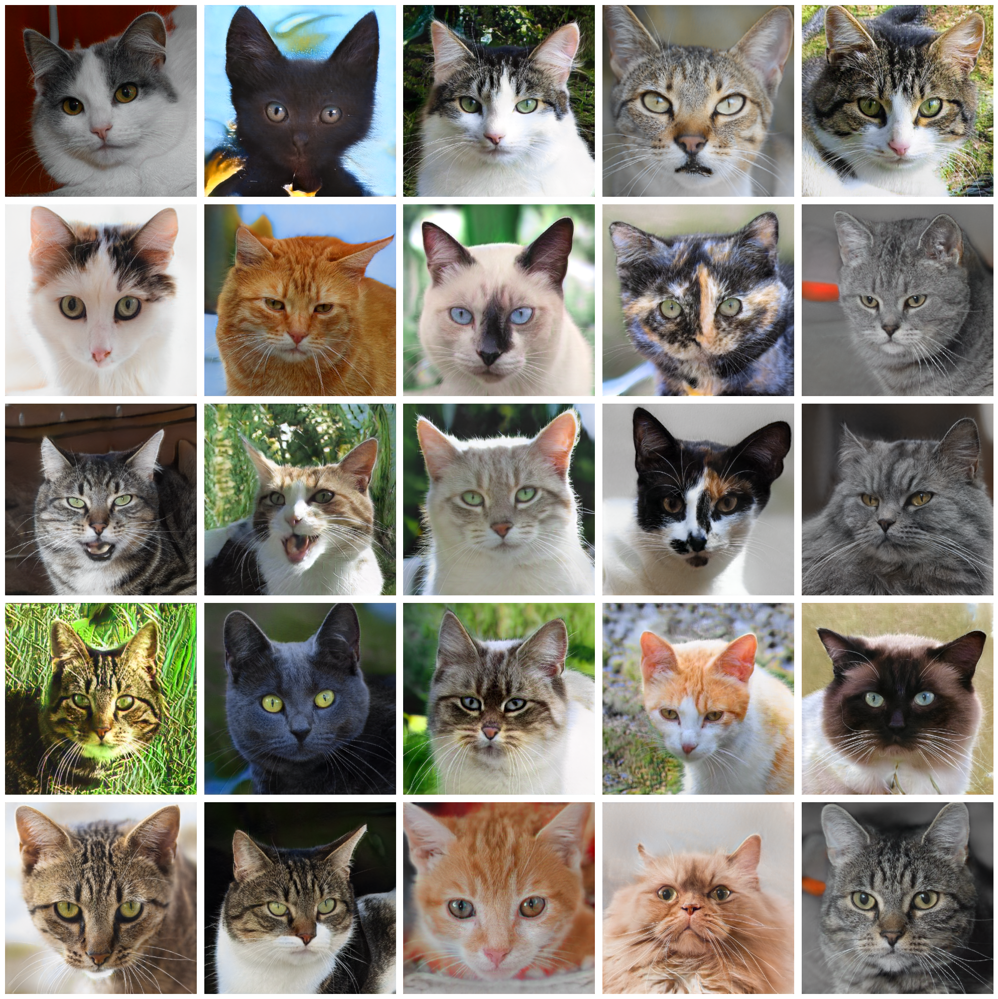

In [5]:
plot_images(r'C:\Users\joaov_zm1q2wh\python\stylegan2_ada_evaluation\dataset\gan_generated\train\cat')

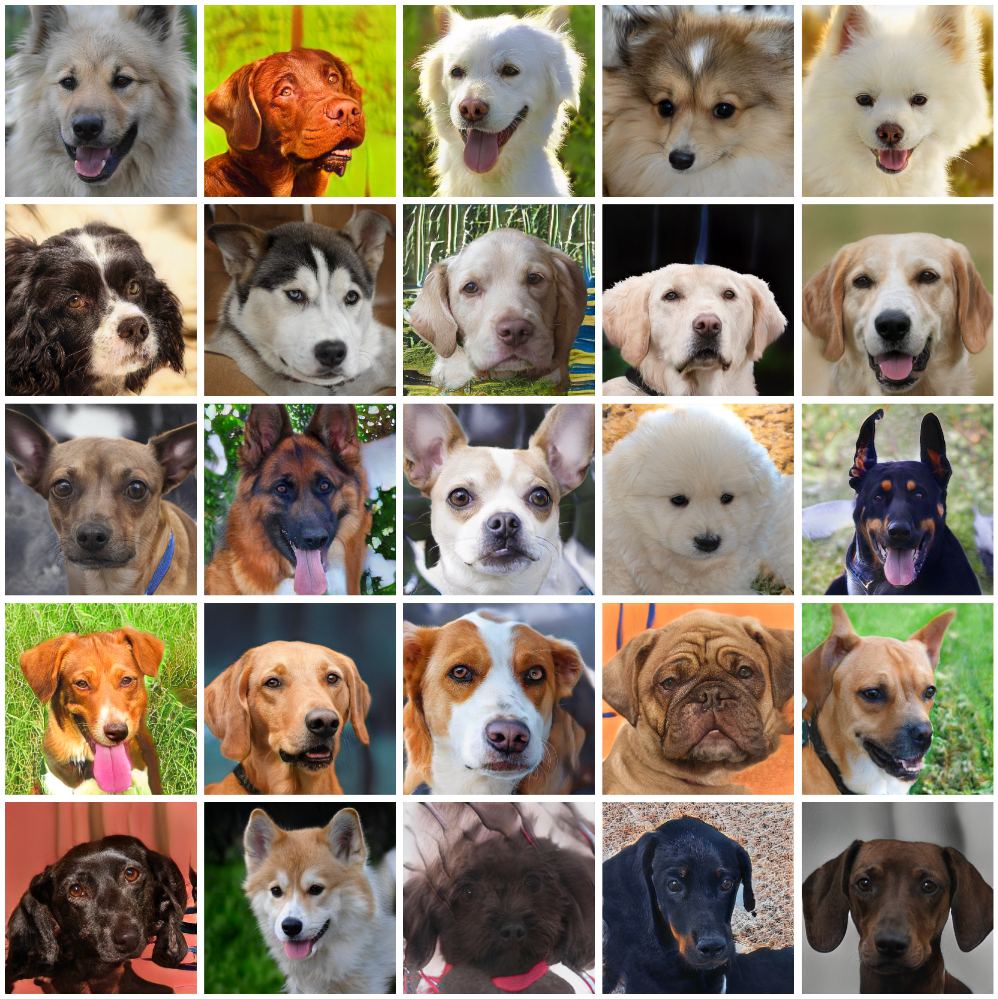

In [6]:
plot_images(r'C:\Users\joaov_zm1q2wh\python\stylegan2_ada_evaluation\dataset\gan_generated\train\dog')

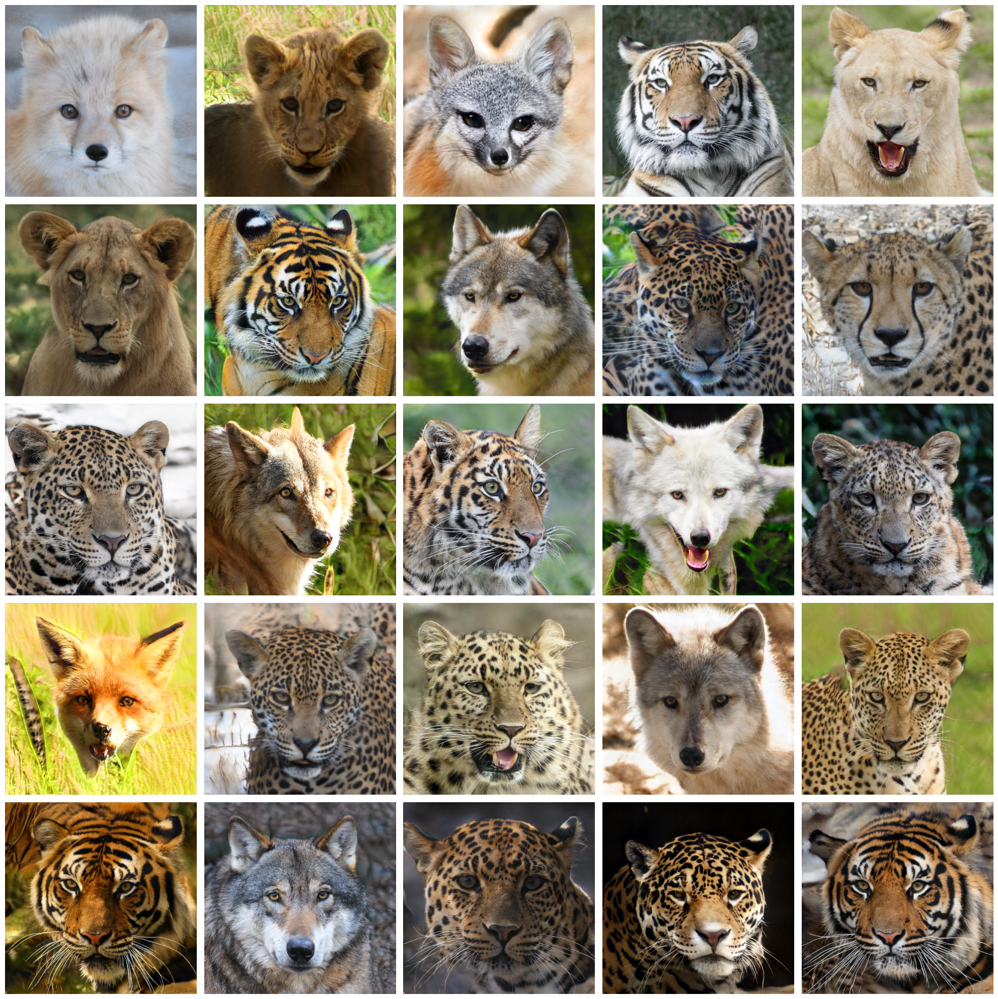

In [28]:
plot_images(r'C:\Users\joaov_zm1q2wh\python\stylegan2_ada_evaluation\dataset\gan_generated\train\wild')

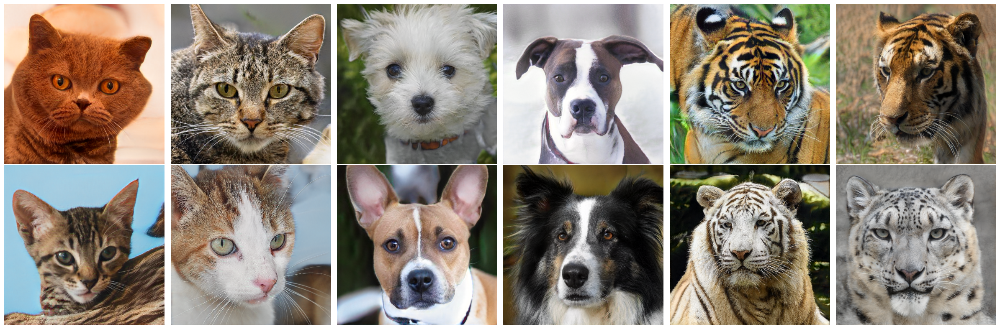

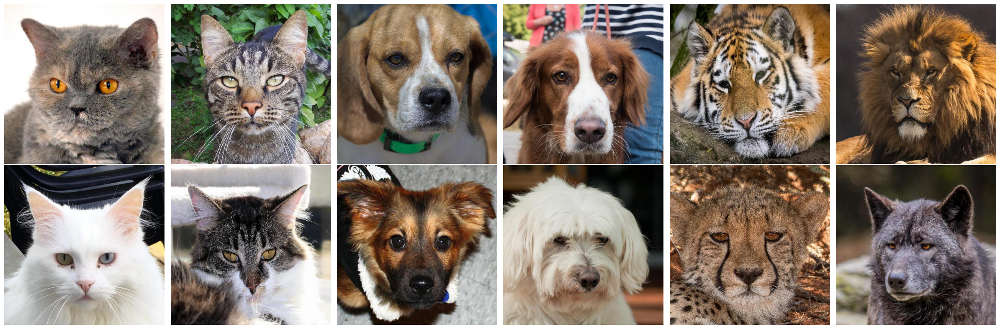

In [1]:
import os
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

def plot_images_mixed(cat_dir, dog_dir, wild_dir):
    N_ROWS = 2
    N_COLS = 6
    N_PER_CATEGORY = 4

    def get_random_images(img_dir, count):
        if not os.path.isdir(img_dir):
            print(f"Diretório não encontrado: {img_dir}")
            return []
            
        all_files = os.listdir(img_dir)
        
        img_paths = [
            os.path.join(img_dir, file) 
            for file in all_files 
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.webp'))
        ]
        
        return random.sample(img_paths, min(len(img_paths), count))

    cat_files = get_random_images(cat_dir, N_PER_CATEGORY)
    dog_files = get_random_images(dog_dir, N_PER_CATEGORY)
    wild_files = get_random_images(wild_dir, N_PER_CATEGORY)
    
    if len(cat_files) < 2 or len(dog_files) < 2 or len(wild_files) < 2:
         print("Não há imagens suficientes (mínimo 2 por categoria) para o layout desejado.")
         return

    plot_order = []
    
    plot_order.extend(cat_files[0:2])
    plot_order.extend(dog_files[0:2])
    plot_order.extend(wild_files[0:2])
    
    plot_order.extend(cat_files[2:4])
    plot_order.extend(dog_files[2:4])
    plot_order.extend(wild_files[2:4])
    
    plt.figure(figsize=(24, 8))

    for idx, img_path in enumerate(plot_order):
        plt.subplot(N_ROWS, N_COLS, idx + 1)
        
        try:
            img = mpimg.imread(img_path) 
            plt.imshow(img)
            category = os.path.basename(os.path.dirname(img_path)).capitalize()
            # plt.title(f"{category} ({idx + 1})") 
            
            plt.axis('off')
        except Exception as e:
            plt.axis('off')
            print(f"Erro ao carregar imagem {img_path}: {e}")
            
    plt.tight_layout()
    plt.show()

# print(os.getcwd())
cat_dir_path = "../dataset/gan_generated/train/cat"
dog_dir_path = "../dataset/gan_generated/train/dog"
wild_dir_path = "../dataset/gan_generated/train/wild"
plot_images_mixed(cat_dir_path, dog_dir_path, wild_dir_path)

cat_dir_path = "../dataset/real/train/cat"
dog_dir_path = "../dataset/real/train/dog"
wild_dir_path = "../dataset/real/train/wild"
plot_images_mixed(cat_dir_path, dog_dir_path, wild_dir_path)


## 🐾 Avaliação: Experimentos de Classificação AFHQ (GAN vs. Data Augumentaion Standard)

Esta avaliação foi projetada para comparar o desempenho de modelos de classificação de imagens (como ResNet50 e EfficientNet-B0) em diferentes cenários de conjunto de dados, com foco na eficácia de imagens geradas por GAN como dados de aumento (*data augmentation*).

Você pode executar experimentos individuais ou a suíte completa de testes.

Para executar um experimento específico definindo o modelo, o cenário de dados e o número de épocas.

| Argumento | Descrição |
| :--- | :--- |
| `--data_root` | Caminho para o diretório principal do conjunto de dados (`dataset/`). |
| `--outdir` | Diretório onde os resultados serão salvos. |
| `--model` | Modelo de classificação a ser usado. Ex: `resnet50`, `efficientnet-b0`. |
| `--scenario` | Cenário de dados. Ex: `real_only` (apenas dados reais). |
| `--epochs` | Número de épocas de treinamento. |

```bash
python afhq_classification_experiment.py --data_root /caminho/para/dataset --outdir /resultados/exp --model resnet50 --scenario real_only --epochs 20
```

Para executar todos os cenários e modelos predefinidos.

| Argumento | Descrição |
| :--- | :--- |
| `--run_all` | Sinaliza para executar todos os cenários e modelos. |
| `--gpus` | Número de GPUs a serem utilizadas (ex: `1`). |

```bash
python afhq_classification_experiment.py --data_root /caminho/para/dataset --outdir /resultados/exp --run_all --epochs 20 --gpus 1
```

O script gera várias informações para análise detalhada do desempenho:

- **Resumo de Resultados:** Um arquivo **CSV** consolidando as métricas de todos os experimentos executados.
- **Logs:** Logs detalhados por experimento.
- **Gráficos:**
  - **Plots de Treinamento/Avaliação** (Loss e Acurácia)
- **Avaliação:**
  - **Matrizes de Confusão** salvas como imagens.

##### Estrutura de Diretório Esperada

Espero que o diretório `data_root` (ex: `dataset/`) siga a seguinte estrutura hierárquica para carregar os dados reais e os dados gerados por GAN:

```
dataset/
 ├── real/
 │    ├── train/ 
 │    │    ├── class1/ 
 │    │    │    └── *.jpg (Imagens de Treino Reais)
 │    │    └── class2/ 
 │    └── test/ 
 │         ├── class1/ 
 │         └── class2/ (Imagens de Teste Reais)
 └── gan_generated/ 
      └── train/
           ├── class1/ 
           │    └── *.jpg (Imagens Geradas por GAN para Aumento)
           └── class2/ 
```

Notas Importante: Utilizei modelos da biblioteca **`torchvision`** (`ResNet50` e `EfficientNet-B0`) que são pré-treinados no conjunto de dados **ImageNet**.

### Bibliotecas

In [2]:
import os
import sys
import time
import csv
import json
import math
import random
import argparse
from PIL import Image
from pathlib import Path
from unittest.mock import patch

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, ConcatDataset
from torchvision import transforms, datasets, models

from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report

### Verificação do padrão da imagens

In [3]:
def check_image_dimensions(image_path):
    try:
        img = Image.open(image_path)
        width, height = img.size
        img.close()
        
        return width, height
        
    except FileNotFoundError:
        print(f"Error: File not found at {image_path}")
        return None, None
    except Exception as e:
        print(f"Error processing the image at {image_path}: {e}")
        return None, None

genereted_image_path = '../dataset/gan_generated/train/cat/seed0000.png'
real_image_path = '../dataset/real/train/cat/flickr_cat_000002.jpg'

width, height = check_image_dimensions(genereted_image_path)
print(f"Genereted image dimensions: {width}px wide x {height}px high")

width, height = check_image_dimensions(real_image_path)
print(f"Real image dimensions: {width}px wide x {height}px high")

Genereted image dimensions: 512px wide x 512px high
Real image dimensions: 512px wide x 512px high


### Core

In [2]:
# Utilities
def seed_everything(seed=42):
    random.seed(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)

def ensure_dir(path):
    os.makedirs(path, exist_ok=True)

def save_csv(path, rows, header=None):
    with open(path, 'w', newline='') as f:
        writer = csv.writer(f)
        if header:
            writer.writerow(header)
        writer.writerows(rows)

# Dataset helpers
def build_transforms(scenario, img_size=256):
    test_transform = transforms.Compose([
        transforms.Resize((img_size, img_size)),
        transforms.ToTensor(),
        transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
    ])

    if scenario == 'real_aug_standard':
        train_transform = transforms.Compose([
            transforms.Resize((img_size, img_size)),
            transforms.RandomHorizontalFlip(),
            transforms.RandomRotation(15),
            transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.1, hue=0.05),
            transforms.ToTensor(),
            transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
        ])
    else:
        # minimal transforms for other scenarios; augmentation from GAN is external
        train_transform = transforms.Compose([
            transforms.Resize((img_size, img_size)),
            transforms.ToTensor(),
            transforms.Normalize([0.5,0.5,0.5],[0.5,0.5,0.5])
        ])

    return train_transform, test_transform

def build_dataloaders(data_root, scenario, batch_size=32, img_size=256, num_workers=4):
    train_transform, test_transform = build_transforms(scenario, img_size=img_size)

    real_train_dir = os.path.join(data_root, 'real', 'train')
    real_test_dir  = os.path.join(data_root, 'real', 'val')
    gan_train_dir  = os.path.join(data_root, 'gan_generated', 'train')

    # datasets
    real_train_ds = datasets.ImageFolder(real_train_dir, transform=train_transform)
    real_test_ds  = datasets.ImageFolder(real_test_dir, transform=test_transform)

    if scenario == 'real_only':
        train_ds = real_train_ds
    elif scenario == 'generated_only':
        train_ds = datasets.ImageFolder(gan_train_dir, transform=train_transform)
    elif scenario == 'real_plus_gan':
        gen_ds = datasets.ImageFolder(gan_train_dir, transform=train_transform)
        train_ds = ConcatDataset([real_train_ds, gen_ds])
    elif scenario == 'real_aug_standard':
        train_ds = real_train_ds
    else:
        raise ValueError('Unknown scenario: ' + scenario)

    # Build loaders
    train_loader = DataLoader(train_ds, batch_size=batch_size, shuffle=True, num_workers=num_workers, pin_memory=True)
    test_loader  = DataLoader(real_test_ds, batch_size=batch_size, shuffle=False, num_workers=num_workers, pin_memory=True)

    # class names (from real train dataset)
    class_names = real_train_ds.classes
    return train_loader, test_loader, class_names

# Models
def get_model(name, num_classes, pretrained=True, device='cpu'):
    name = name.lower()
    if name == 'resnet50':
        model = models.resnet50(weights=models.ResNet50_Weights.IMAGENET1K_V2 if pretrained else None)
        in_features = model.fc.in_features
        model.fc = nn.Linear(in_features, num_classes)
    elif name.startswith('efficientnet'):
        # using efficientnet_b0 as default
        model = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.IMAGENET1K_V1 if pretrained else None)
        in_features = model.classifier[1].in_features
        model.classifier[1] = nn.Linear(in_features, num_classes)
    else:
        raise ValueError('Unsupported model: ' + name)
    return model.to(device)

# Training & Eval
def train_one_epoch(model, loader, criterion, optimizer, device):
    model.train()
    running_loss = 0.0
    all_preds = []
    all_targets = []
    for imgs, labels in loader:
        imgs = imgs.to(device)
        labels = labels.to(device)
        optimizer.zero_grad()
        outputs = model(imgs)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()

        running_loss += loss.item() * imgs.size(0)
        preds = torch.argmax(outputs.detach(), dim=1).cpu().numpy()
        all_preds.extend(preds.tolist())
        all_targets.extend(labels.detach().cpu().numpy().tolist())

    epoch_loss = running_loss / len(loader.dataset)
    epoch_acc = accuracy_score(all_targets, all_preds)
    return epoch_loss, epoch_acc

def evaluate(model, loader, device):
    model.eval()
    all_preds = []
    all_targets = []
    with torch.no_grad():
        for imgs, labels in loader:
            imgs = imgs.to(device)
            outputs = model(imgs)
            preds = torch.argmax(outputs, dim=1).cpu().numpy()
            all_preds.extend(preds.tolist())
            all_targets.extend(labels.detach().cpu().numpy().tolist())

    acc = accuracy_score(all_targets, all_preds)
    prec = precision_score(all_targets, all_preds, average='macro', zero_division=0)
    rec  = recall_score(all_targets, all_preds, average='macro', zero_division=0)
    f1   = f1_score(all_targets, all_preds, average='macro', zero_division=0)
    cm   = confusion_matrix(all_targets, all_preds)
    report = classification_report(all_targets, all_preds, target_names=None, zero_division=0)
    return {'accuracy': acc, 'precision': prec, 'recall': rec, 'f1': f1, 'confusion_matrix': cm, 'report': report, 'y_true': all_targets, 'y_pred': all_preds}

# Experiment Runner
def run_experiment(data_root, outdir, model_name, scenario, epochs=20, batch_size=32, img_size=256, lr=1e-4, device='cuda', num_workers=4):
    ensure_dir(outdir)
    seed_everything(42)
    train_loader, test_loader, class_names = build_dataloaders(data_root, scenario, batch_size=batch_size, img_size=img_size, num_workers=num_workers)
    num_classes = len(class_names)
    model = get_model(model_name, num_classes=num_classes, pretrained=True, device=device)
    criterion = nn.CrossEntropyLoss()
    optimizer = optim.AdamW(model.parameters(), lr=lr)

    history = {'epoch': [], 'train_loss': [], 'train_acc': [], 'test_acc': [], 'test_f1': [], 'test_precision': [], 'test_recall': []}

    best_val = -1.0
    best_model_path = os.path.join(outdir, f'best_{model_name}_{scenario}.pth')

    for epoch in range(1, epochs+1):
        t0 = time.time()
        train_loss, train_acc = train_one_epoch(model, train_loader, criterion, optimizer, device)
        val_metrics = evaluate(model, test_loader, device)
        t1 = time.time()

        history['epoch'].append(epoch)
        history['train_loss'].append(train_loss)
        history['train_acc'].append(train_acc)
        history['test_acc'].append(val_metrics['accuracy'])
        history['test_f1'].append(val_metrics['f1'])
        history['test_precision'].append(val_metrics['precision'])
        history['test_recall'].append(val_metrics['recall'])

        print(f'Epoch {epoch}/{epochs}  train_loss={train_loss:.4f} train_acc={train_acc:.4f} test_acc={val_metrics["accuracy"]:.4f} time={t1-t0:.1f}s')

        # save best
        if val_metrics['f1'] > best_val:
            best_val = val_metrics['f1']
            torch.save(model.state_dict(), best_model_path)

    # Save history CSV
    hist_df = pd.DataFrame(history)
    hist_csv = os.path.join(outdir, f'history_{model_name}_{scenario}.csv')
    hist_df.to_csv(hist_csv, index=False)

    # Save final evaluation
    final_eval = evaluate(model, test_loader, device)
    eval_json = os.path.join(outdir, f'eval_{model_name}_{scenario}.json')
    with open(eval_json, 'w') as f:
        json.dump({k: (v.tolist() if isinstance(v, np.ndarray) else v) for k, v in final_eval.items() if k != 'report'}, f, indent=2)

    # Save confusion matrix figure
    cm = final_eval['confusion_matrix']
    fig, ax = plt.subplots()
    ax.imshow(cm)
    ax.set_title(f'Confusion matrix: {model_name} - {scenario}')
    ax.set_xlabel('Predicted')
    ax.set_ylabel('True')
    fig_path = os.path.join(outdir, f'confusion_{model_name}_{scenario}.png')
    fig.savefig(fig_path)
    plt.close(fig)

    return {'history_csv': hist_csv, 'eval_json': eval_json, 'best_model': best_model_path, 'confusion_png': fig_path, 'class_names': class_names}

# Plotting & Comparison
def plot_history(csv_paths, outdir):
    ensure_dir(outdir)
    for p in csv_paths:
        df = pd.read_csv(p)
        base = Path(p).stem
        fig, ax = plt.subplots()
        ax.plot(df['epoch'], df['train_loss'], label='train_loss')
        ax.set_xlabel('epoch')
        ax.set_ylabel('train_loss')
        ax.set_title(base)
        fig.savefig(os.path.join(outdir, f'{base}_loss.png'))
        plt.close(fig)

        fig2, ax2 = plt.subplots()
        ax2.plot(df['epoch'], df['train_acc'], label='train_acc')
        ax2.plot(df['epoch'], df['test_acc'], label='test_acc')
        ax2.set_xlabel('epoch')
        ax2.set_ylabel('accuracy')
        ax2.legend()
        fig2.savefig(os.path.join(outdir, f'{base}_acc.png'))
        plt.close(fig2)

def aggregate_results(result_records, outdir):
    df = pd.DataFrame(result_records)
    csv_path = os.path.join(outdir, 'summary_results.csv')
    df.to_csv(csv_path, index=False)
    return csv_path, df

# CLI
def parse_args():
    parser = argparse.ArgumentParser()
    parser.add_argument('--data_root', required=True, help='Root dataset folder')
    parser.add_argument('--outdir', required=True, help='Output folder for all logs and models')
    parser.add_argument('--model', choices=['resnet50','efficientnet_b0'], default='resnet50')
    parser.add_argument('--scenario', choices=['real_only','generated_only','real_plus_gan','real_aug_standard'], default='real_only')
    parser.add_argument('--epochs', type=int, default=20)
    parser.add_argument('--batch', type=int, default=32)
    parser.add_argument('--img_size', type=int, default=256)
    parser.add_argument('--lr', type=float, default=1e-4)
    parser.add_argument('--device', default='cuda' if torch.cuda.is_available() else 'cpu')
    parser.add_argument('--num_workers', type=int, default=4)
    parser.add_argument('--run_all', action='store_true', help='Run all scenarios sequentially (overrides --scenario)')
    parser.add_argument('--gpus', type=int, default=1)
    return parser.parse_args()

def main():
    args = parse_args()
    ensure_dir(args.outdir)
    scenarios = ['real_only','generated_only','real_plus_gan','real_aug_standard'] if args.run_all else [args.scenario]
    records = []

    for scen in scenarios:
        print('Running scenario:', scen)
        scen_out = os.path.join(args.outdir, f'{args.model}_{scen}')
        ensure_dir(scen_out)
        res = run_experiment(args.data_root, scen_out, args.model, scen, epochs=args.epochs, batch_size=args.batch, img_size=args.img_size, lr=args.lr, device=args.device, num_workers=args.num_workers)
        # load evaluation
        with open(res['eval_json'], 'r') as f:
            ev = json.load(f)
        record = {
            'model': args.model,
            'scenario': scen,
            'accuracy': ev.get('accuracy'),
            'f1': ev.get('f1'),
            'precision': ev.get('precision'),
            'recall': ev.get('recall'),
            'history_csv': res['history_csv'],
            'confusion_png': res['confusion_png'],
            'best_model': res['best_model']
        }
        records.append(record)

    # Save aggregated CSV
    summary_csv, df = aggregate_results(records, args.outdir)
    print('Summary saved to', summary_csv)
    # Save plots for histories
    csvs = [r['history_csv'] for r in records]
    plot_history(csvs, args.outdir)
    print('Plots saved in', args.outdir)

### MAIN ->🗿🥊CHAMA!

In [ ]:
def run_all_models_and_scenarios():   
    all_models = ['resnet50', 'efficientnet_b0']
    
    base_args = {
        'data_root': '../dataset',
        'outdir': './results_full_run',
        'epochs': '5',
        'batch': '64',
        'lr': '1e-3',
        'device': 'cuda' if torch.cuda.is_available() else 'cpu', 
        'run_all': True
    }

    print("START PIPELINE")
    
    for model_name in all_models:
        print(f"#"*42)
        print(f"## Model {model_name.upper()} (All Scenarios) ##")
        print(f"#"*42)
        
        new_sys_argv = [
            '<main.py>', 
            '--data_root', base_args['data_root'], 
            '--outdir', base_args['outdir'], 
            '--model', model_name,
            '--epochs', base_args['epochs'],
            '--batch', base_args['batch'],
            '--lr', base_args['lr'],
            '--device', base_args['device'],
        ]
        
        if base_args['run_all']:
            new_sys_argv.append('--run_all')

        sys.argv = new_sys_argv
        
        try:
            main()
            print(f"\nExperimento {model_name} concluído com sucesso!")
        except SystemExit as e:
            if e.code != 0:
                print(f"ERRO CRÍTICO no experimento {model_name} (código de saída: {e.code}).")
                
run_all_models_and_scenarios()

<b>Desempenho Superior:</b>

Os cenários Real + GAN e Real + Aug. Padrão (linhas sólidas e tracejadas, respectivamente) demonstram o melhor desempenho e a maior estabilidade, com a acurácia de teste consistentemente acima de 0.99.

<b>Volatilidade:</b>

O cenário Apenas Real (linhas sólidas finas) mostra uma acurácia alta, mas com mais oscilações, especialmente no modelo EfficientNet-B0, confirmando a sensibilidade ao pequeno conjunto de dados real.

<b>Problema de Generalização:</b>

O cenário Apenas GAN (linhas tracejadas longas) apresenta a maior volatilidade e o pior desempenho de generalização, com quedas significativas na acurácia de teste, especialmente para o modelo EfficientNet-B0.

In [7]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from pathlib import Path

def get_scenario_description(base_name):
    parts = base_name.split('_')
    model = parts[0].upper() + '-' + parts[1].upper()
    scenario = '_'.join(parts[2:])
    
    scenario_map = {
        'real_only': 'Apenas Dados Reais',
        'generated_only': 'Apenas Dados Gerados (GAN)',
        'real_plus_gan': 'Dados Reais + Dados Gerados (GAN)',
        'real_aug_standard': 'Dados Reais com Aumento Padrão'
    }
    
    description = scenario_map.get(scenario, scenario)
    return f'{model} - Cenário: {description}'

def plot_history_article_standard(csv_paths, outdir):
    os.makedirs(outdir, exist_ok=True)
    plt.style.use('seaborn-v0_8-whitegrid')
    
    for p in csv_paths:
        df = pd.read_csv(p)
        base = Path(p).stem
        title_desc = get_scenario_description(base.replace('history_', ''))
        
        # Gráfico de Perda
        fig_loss, ax_loss = plt.subplots(figsize=(8, 6))
        ax_loss.plot(df['epoch'], df['train_loss'], label='Perda de Treinamento', color='blue', linewidth=2)
        
        ax_loss.set_xlabel('Época', fontsize=12)
        ax_loss.set_ylabel('Perda (Loss)', fontsize=12)
        ax_loss.set_title(f'Curva de Perda - {title_desc}', fontsize=14, fontweight='bold')
        ax_loss.legend(fontsize=10)
        
        # Se precisar, pode ajustar os limites do eixo Y para melhor visualização
        ax_loss.set_ylim(bottom=0)
        
        fig_loss.tight_layout()
        fig_loss.savefig(os.path.join(outdir, f'{base}_loss_article.png'), dpi=300)
        plt.close(fig_loss)
        
        # Gráfico de Acurácia
        fig_acc, ax_acc = plt.subplots(figsize=(8, 6))
        ax_acc.plot(df['epoch'], df['train_acc'], label='Acurácia de Treinamento', color='blue', linestyle='-', linewidth=2)
        ax_acc.plot(df['epoch'], df['test_acc'], label='Acurácia de Teste', color='orange', linestyle='--', linewidth=2)
        
        ax_acc.set_xlabel('Época', fontsize=12)
        ax_acc.set_ylabel('Acurácia', fontsize=12)
        ax_acc.set_title(f'Curva de Acurácia - {title_desc}', fontsize=14, fontweight='bold')
        ax_acc.legend(fontsize=10, loc='lower right')
        
        # Ajustar limites do eixo Y para focar na região de interesse (0.95 a 1.0)
        ax_acc.set_ylim(0.95, 1.005)
        
        fig_acc.tight_layout()
        fig_acc.savefig(os.path.join(outdir, f'{base}_acc_article.png'), dpi=300)
        plt.close(fig_acc)

def plot_model_side_by_side(results_dir, outdir):
    os.makedirs(outdir, exist_ok=True)
    plt.style.use('seaborn-v0_8-whitegrid')

    models = {
        'efficientnet_b0': ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728'],
        'resnet50':        ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728']
    }

    scenarios = ['real_only', 'generated_only', 'real_plus_gan', 'real_aug_standard']

    line_styles = {
        'real_only': '-',
        'generated_only': '--',
        'real_plus_gan': '-.',
        'real_aug_standard': ':'
    }

    scenario_names_pt = {
        'real_only': 'Apenas Dados Reais',
        'generated_only': 'Apenas Dados Gerados (GAN)',
        'real_plus_gan': 'Reais + Gerados (GAN)',
        'real_aug_standard': 'Reais + Aumento Padrão'
    }

    for model_name, colors in models.items():

        # ---------------------
        # ACURÁCIA
        # ---------------------
        fig_acc, ax_acc = plt.subplots(figsize=(10, 7))

        for i, scen in enumerate(scenarios):
            csv_path = Path(results_dir) / f'{model_name}_{scen}' / f'history_{model_name}_{scen}.csv'
            if not csv_path.exists():
                continue

            df = pd.read_csv(csv_path)

            ax_acc.plot(
                df['epoch'], df['test_acc'],
                label=scenario_names_pt[scen],
                color=colors[i],
                linestyle=line_styles[scen],
                linewidth=2
            )

        ax_acc.set_xlabel('Época', fontsize=14)
        ax_acc.set_ylabel('Acurácia de Teste', fontsize=14)
        ax_acc.set_title(f'Comparação dos 4 Cenários – {model_name.upper()} (Acurácia)', fontsize=16, fontweight='bold')
        ax_acc.set_ylim(0.95, 1.005)
        ax_acc.legend(fontsize=10, loc='lower right')

        fig_acc.tight_layout()
        fig_acc.savefig(os.path.join(outdir, f'comparativo_{model_name}_acc.png'), dpi=300)
        plt.close(fig_acc)

        # ---------------------
        # LOSS (treinamento)
        # ---------------------
        fig_loss, ax_loss = plt.subplots(figsize=(10, 7))

        for i, scen in enumerate(scenarios):
            csv_path = Path(results_dir) / f'{model_name}_{scen}' / f'history_{model_name}_{scen}.csv'
            if not csv_path.exists():
                continue

            df = pd.read_csv(csv_path)

            ax_loss.plot(
                df['epoch'], df['train_loss'],
                label=scenario_names_pt[scen],
                color=colors[i],
                linestyle=line_styles[scen],
                linewidth=2
            )

        ax_loss.set_xlabel('Época', fontsize=14)
        ax_loss.set_ylabel('Perda (Loss) de Treinamento', fontsize=14)
        ax_loss.set_title(f'Comparação dos 4 Cenários – {model_name.upper()} (Loss)', fontsize=16, fontweight='bold')
        ax_loss.set_ylim(bottom=0)
        ax_loss.legend(fontsize=10, loc='upper right')

        fig_loss.tight_layout()
        fig_loss.savefig(os.path.join(outdir, f'comparativo_{model_name}_loss.png'), dpi=300)
        plt.close(fig_loss)

if __name__ == '__main__':
    results_dir = './results_full_run'
    output_dir = '../docs/latex'
    
    csv_files = list(Path(results_dir).glob('*/history_*.csv'))
    
    csv_paths = []
    scenarios = [
        'efficientnet_b0_generated_only', 'efficientnet_b0_real_aug_standard', 'efficientnet_b0_real_only', 'efficientnet_b0_real_plus_gan',
        'resnet50_generated_only', 'resnet50_real_aug_standard', 'resnet50_real_only', 'resnet50_real_plus_gan'
    ]
    
    for scen in scenarios:
        csv_path = Path(results_dir) / scen / f'history_{scen}.csv'
        if csv_path.exists():
            csv_paths.append(str(csv_path))
            
    if not csv_paths:
        print("Nenhum arquivo CSV de histórico encontrado. Verifique a estrutura de diretórios.")
    else:
        print(f"Encontrados {len(csv_paths)} arquivos CSV. Gerando gráficos...")
        plot_history_article_standard(csv_paths, output_dir)
        plot_model_side_by_side(results_dir, output_dir)
        print(f"Gráficos gerados e salvos em: {output_dir}")

Encontrados 8 arquivos CSV. Gerando gráficos...
Gráficos gerados e salvos em: ../docs/latex
